# Project: No Kangaroos in Austria

*The complete source code can be found under https://github.com/Declaminius/GeoGuessr-AI.*

In [1]:
import os
os.environ['USE_PYGEOS'] = '0'
import osmnx as ox
import pandas as pd
import numpy as np
import csv
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, optimizers, losses

# Local configuration file
import config

# Local data visualization library
import data_visualization


plt.rcParams.update({"text.usetex": True})

train_ds_unbatched = config.train_ds.unbatch()
val_ds_unbatched = config.val_ds.unbatch()

train_ds32_unbatched = config.train_ds32.unbatch()
val_ds32_unbatched = config.val_ds32.unbatch()

2023-03-14 17:42:15.489744: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Found 25062 files belonging to 2 classes.
Using 20050 files for training.
Using 5012 files for validation.
Found 25062 files belonging to 2 classes.
Using 20050 files for training.
Using 5012 files for validation.
Found 55053 files belonging to 5 classes.
Using 44043 files for training.
Using 11010 files for validation.
Found 25062 files belonging to 2 classes.


## Motivation

In the game GeoGuessr the player is dropped on a random location within Google Streetview with the goal to
determine his location as precisely as possible. In the simplest case, we are not allowed to move from our starting
position, pan around nor zoom in the initial image.

| ![Geoguessr Example](example.PNG) | 
|:--:| 
| *Example of a game of GeoGuessr* |

Hence the goal of this Machine Learning project is to map static Street View images to location data. This setting
naturally allows for either regression, where we aim to predict the latitude and longitude of any given image, or
classification, if we ask to classify the images into pre-defined geographic regions, like countries or continents.
I want to focus on the classification task, where images are classified into the countries, where they are taken
in. A good starting point would then be to pick two distinct countries, like Austria and Australia. Once a model works well for the binary classification task, I will also try to extend it to a multinomial classification problem by adding more (and more difficult) countries.
 

## Generating the dataset

To obtain our dataset, we first sample points from street network graphs obtained via the Overpass API with the goal of obtaining coordinates of locations that likely have street view coverage. These coordinates can then in turn be fed into the Static Street View API to obtain the images for our dataset.


### Street network graphs

In order not to overwhelm the poor Overpass API, it was necessary to first split the queries for entire countries into queries of individual states, whose network size was more manageable. 
This approach worked well for Austrian states, which are relatively smaller than their Australian counterpart. 
For the bigger Australian states, however I had to resort to a different tool, where I instead downloaded the respective .osm-Files from a PlanetOSM mirror and used the handy command-line tool osmosis to filter the relevant parts of street network.

In [2]:
class StreetNetwork:

    def __init__(self, state, country, osm_filepath = None):
        self.osm_filepath = osm_filepath
        self.state = state
        self.country = country
        self.network = None
        self.saved_graph = False

        self.savefolder = f"../street_networks/{self.country}"
        if not os.path.exists(self.savefolder):
            os.makedirs(self.savefolder)

    def load_network(self, file = None):
        if file is not None:
            self.network = ox.load_graphml(file)
        else:
            if self.saved_graph:
                self.network = ox.load_graphml(os.path.join(self.savefolder, f"{self.state}.graphml"))
            else:
                raise Exception("No savefile specified to load the network from")

    def plot_network(self):
        if self.network is not None:
            ox.plot_graph(self.network)
        else:
            raise Exception("Graph not yet generated")

    def generate_network_overpass(self, filter):
        try:
            location = {'state': self.state, 'country': self.country}
            self.network = ox.graph_from_place(location, network_type="drive", custom_filter = filter)
        except Exception as e:
            warnings.warn(f"Using city instead of state for {self.state}") 
            location = {'city': self.state, 'country': self.country}
            self.network = ox.graph_from_place(location, network_type="drive", custom_filter = filter)
        self.save_network()         
        
    def generate_network_osm(self):
        self.network = ox.graph_from_xml(self.osm_filepath)
        self.save_network() 

    def generate_network_pyrosm(self):
        osm = pyrosm.OSM(self.filepath)
        nodes, edges = osm.get_network(network_type = "driving", nodes = True)
        self.network = osm.to_graph(nodes, edges, graph_type="networkx", retain_all=True)
        self.save_network() 

    def save_network(self):
        if self.network is not None:
            savefile = os.path.join(self.savefolder, f"{self.state}.graphml")
            ox.save_graphml(self.network, savefile)
            self.save_stats()
            self.saved_graph = True
        else:
            raise Exception("Network not yet generated.")

    def save_stats(self):
        savefile = os.path.join(self.savefolder, f"{self.state}.csv")
        try:
            stats = ox.basic_stats(self.network, clean_int_tol=15)
        except Exception as e:
            print(e)
            stats = {"n": len(self.network.nodes), "m": len(self.network.edges)}

        with open(savefile, "w", newline="") as file:
            writer = csv.DictWriter(file, fieldnames= stats.keys())
            writer.writeheader()
            writer.writerow(stats)

/opt/conda/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_to_gdfs(G, edges=False)["geometry"].buffer(tolerance).unary_union
/opt/conda/lib/python3.10/site-packages/osmnx/simplification.py:437: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return _merge_nodes_geometric(G, tolerance).centroid


Lower Austria: 5832 nodes and 10980 edges


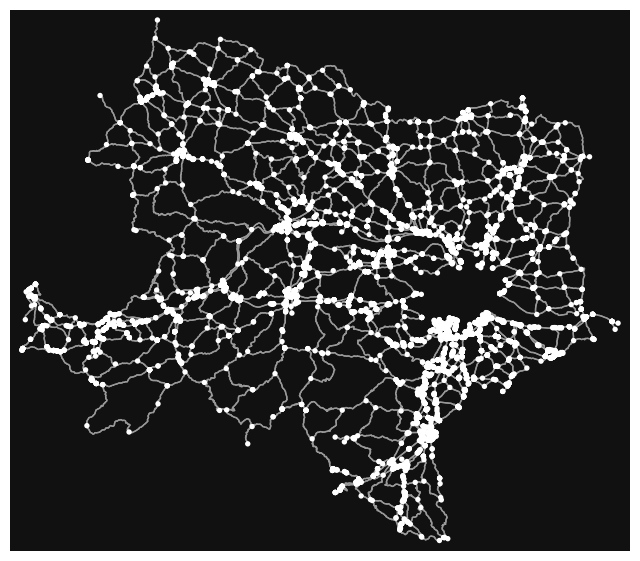

In [5]:
location = {'state': 'Lower Austria', 'country': 'Austria'}

street_network_lower_austria = StreetNetwork(**location)
street_network_lower_austria.generate_network_overpass(config.highway_filter)

basic_stats = ox.basic_stats(street_network_lower_austria.network)
print(f"Lower Austria: {basic_stats['n']} nodes and {basic_stats['m']} edges")
street_network_lower_austria.plot_network()

### Generating images

Given a street network for a certain state, we can now use this graph to sample points along its edges and use
the obtained coordinates to request street view images at this location.

In [2]:
import requests
import warnings
from osmnx.utils_geo import sample_points

class StreetViewImagesForState:
    api_key = os.environ.get('GOOGLE_MAPS_API_KEY')
    streetview_api = 'https://maps.googleapis.com/maps/api/streetview'
    metadata_api = 'https://maps.googleapis.com/maps/api/streetview/metadata'


    def __init__(self, state, country):
        self.state = state
        self.country = country
        self.imagepath = f"../images/{country}/{state}"
        self.graph_file = f"../street_networks/{country}/{state}.graphml"
        self.network = ox.load_graphml(self.graph_file)
        self.csv_fieldnames = ["i", "lat", "lng"]
        self.init_coordinates_csv()
  
    def init_coordinates_csv(self):
        filepath = os.path.join(self.imagepath, "coordinates.csv")
        if not os.path.isfile(filepath):
            if not os.path.exists(self.imagepath):
                os.makedirs(self.imagepath)
            with open (filepath, "w") as file:
                writer = csv.DictWriter(file, fieldnames = self.csv_fieldnames)
                writer.writeheader() 
                self.current_id = 0
        else:
            with open (filepath, "r") as file:
                last_line = file.readlines()[-1].split(",")
                self.current_id = int(last_line[0]) + 1
  
    def generate_points(self, n):
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            return sample_points(self.network, n)
  
    def save_image(self, response):
        if response.status_code == 200:
            if not os.path.exists(self.imagepath):
                os.makedirs(self.imagepath)
            with open(os.path.join(self.imagepath, f'{self.current_id}.jpg'), "wb") as file:
                file.write(response.content)
                self.current_id += 1
        else:
            print(response.json())
            print(f"ERROR in {self.state} at {self.current_id}")

    def save_coordinates(self, coordinates):  
        coordinates_filename = os.path.join(self.imagepath, 'coordinates.csv')
        coordinates["i"] = self.current_id
        with open(coordinates_filename, "a", newline = "") as file:
            writer = csv.DictWriter(file, fieldnames = self.csv_fieldnames)
            if not os.path.isfile(coordinates_filename):
                writer.writeheader() 
            writer.writerow(coordinates)

    def request_image(self, location):
        location = f"{location.y},{location.x}"
        params = {
                'size': '640x640', # max 640x640 pixels
                'location': location,
                'source': 'outdoor',
                'radius': 100,
                'return_error_code': 'true',
                'key': self.api_key,
              }

        # Check first, if an image is available at the given location (metadata-API calls are free)
        metadata = requests.get(self.metadata_api, params).json()

        # If an image is available, save it and its coordinates in the respective folder
        if metadata['status'] == 'OK':
            coordinates = metadata['location']
            image = requests.get(self.streetview_api, params)
            response = (coordinates, image)
            return response
        else:
            return None

In [3]:
num_images = 5

for country in ("Austria", "Australia"):
    for i in range(3):
        state = config.states_dict[country][i]
        fig = plt.figure(figsize = (15,3))
        fig.suptitle(f"Random locations in {state}, {country}", size = 20)

        street_view_images_vienna = StreetViewImagesForState(state = state, country = country)
        sample_coordinates = street_view_images_vienna.generate_points(num_images)
        for i, location in enumerate(sample_coordinates):
            response = street_view_images_vienna.request_image(location)
            while response is None:
                # Regenerate a new location if no image was found
                location = street_view_images_vienna.generate_points(1)
                response = street_view_images_vienna.request_image(location)
            image = response[1]
            with open('image.jpg', 'wb') as file:
                file.write(image.content)
            image.close()
            plt.subplot(1,5,i+1)
            plt.axis('off')
            plt.imshow(mpimg.imread('image.jpg'))
        plt.show()


None


KeyboardInterrupt: 

<Figure size 1500x300 with 0 Axes>

### Distribution of images

For the final step I conducted a quick manual review of the image dataset, in which I removed a few low-quality images (the main source of which where tunnel locations in Austria).
Regarding the size of the dataset I aimed for roughly 12.500 images per country to match the size of the Dogs vs. Cats dataset.
In the following we can see the distribution of locations across states. The number of images then represents the size of the dataset after this initial manual pruning.

In [14]:
for country in ("Austria", "Australia"):
    images_per_country = 0
    locations_per_country = 0
    for state in config.states_dict[country]:
        df = pd.read_csv(f"images/{country}/{state}/coordinates.csv", index_col= "i")
        images_per_country += sum(df['image_exists'])
        locations_per_country += len(df)
    
    print(f"{images_per_country} images out of {locations_per_country} locations in {country}.")


12504 images out of 13128 locations in Austria.
12560 images out of 12599 locations in Australia.


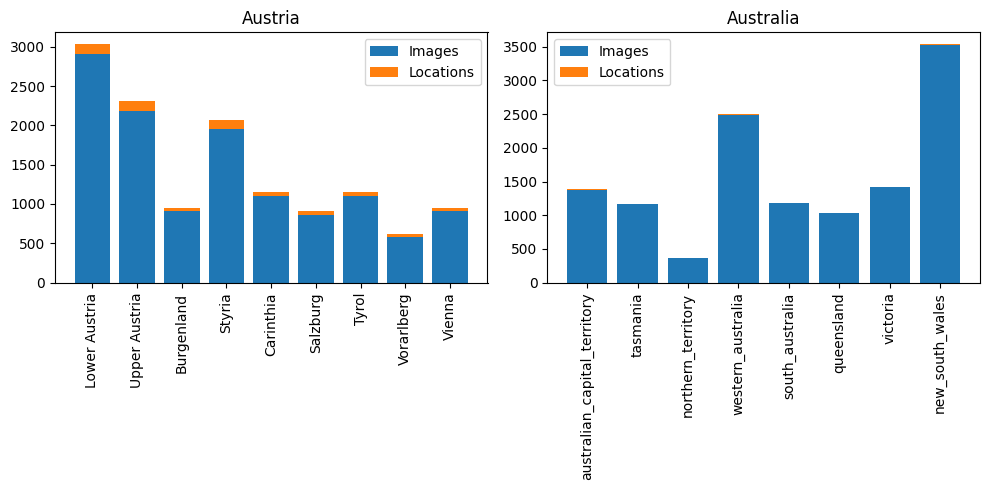

In [12]:
fig, axs = plt.subplots(ncols = 2, figsize = (10,5))
for (i,country) in enumerate(("Austria", "Australia")):
    images_per_state = []
    locations_per_state = []
    for state in config.states_dict[country]:
        df = pd.read_csv(f"images/{country}/{state}/coordinates.csv", index_col= "i")
        images_per_state.append(sum(df["image_exists"]))
        locations_per_state.append(len(df))

    axs[i].bar(config.states_dict[country], images_per_state, label = "Images")
    axs[i].bar(config.states_dict[country], np.array(locations_per_state) - np.array(images_per_state), bottom=images_per_state, label = "Locations")
    axs[i].set_title(country)
    axs[i].tick_params('x', labelrotation=90)
    axs[i].legend()
plt.tight_layout()
plt.show()

### Preprocessing

Before we input the image data into any model, we first standardize the data to a mean of 0 and a standard deviation of 1.
The prefetch function allows for performance optimization by enabling us to load the next batch into memory while processing the current batch.

In [ ]:
from tensorflow.data import AUTOTUNE

def standardize_image(image, label):
    mean = tf.reduce_mean(image)
    std = tf.math.reduce_std(image)
    standardized_image = tf.map_fn(lambda x: (x - mean)/std, image)
    return (standardized_image, label)

def create_standardized_dataset(image_size, image_dir, class_names):
    train_ds, val_ds = keras.utils.image_dataset_from_directory(
        image_dir,
        validation_split=0.2,
        labels="inferred",
        class_names=class_names,
        subset="both",
        seed = 0,
        batch_size = config.batch_size,
        crop_to_aspect_ratio=True,
        image_size=(image_size, image_size))
    
    train_ds = train_ds.map(standardize_image)
    val_ds = val_ds.map(standardize_image)

    train_ds = train_ds.prefetch(buffer_size = AUTOTUNE)
    val_ds = val_ds.prefetch(buffer_size = AUTOTUNE)

    return train_ds, val_ds

## Ridge classificiation

The first simple model that we want to train on our dataset is a Ridge regressor.

Ridge regression is an extension to least squares which introduces an additional regularization parameter $\lambda \geq 0$. As such, the loss is given by:

\begin{align*}
    J_{\mathrm{Ridge}}(\textbf{w}) = \|X\textbf{w} - y\|^2 + \lambda \|\textbf{w}\|^2.
\end{align*}
The regularization parameter $\lambda$ is tasked to control the *generalization* to unseen data.


c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_ridge.py:249: LinAlgWarning: Ill-conditioned matrix (rcond=1.06762e-08): result may not be accurate.
  dual_coef = linalg.solve(K, y, assume_a="pos", overwrite_a=False)
c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_ridge.py:249: LinAlgWarning: Ill-conditioned matrix (rcond=1.16414e-08): result may not be accurate.
  dual_coef = linalg.solve(K, y, assume_a="pos", overwrite_a=False)
c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_ridge.py:249: LinAlgWarning: Ill-conditioned matrix (rcond=1.08235e-08): result may not be accurate.
  dual_coef = linalg.solve(K, y, assume_a="pos", overwrite_a=False)
c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_ridge.py:249: LinAlgWarning: Ill-conditioned matrix (rcond=1.20698e-08): result may not be accurate.
  dual_coef 

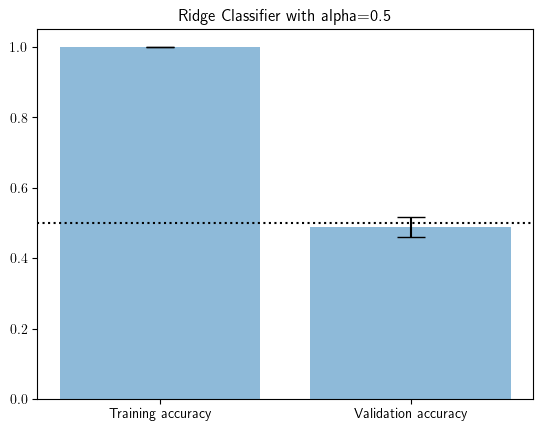

In [2]:
from sklearn import linear_model
from ridge_classifier import evaluate_regressor

alpha = 0.5
sample_size = 500
ridge_classifier = linear_model.RidgeClassifier(alpha = alpha)
ridge_accuracy_array = np.empty((5,2))
for i in range(5):
    train_accuracy, val_accuracy = evaluate_regressor(ridge_classifier, sample_size, train_ds_unbatched, val_ds_unbatched)
    ridge_accuracy_array[i] = np.array([train_accuracy, val_accuracy])
data_visualization.plot_accuracy(ridge_accuracy_array, f'Ridge Classifier with {alpha=}')

This is a clear example of overfitting. The reason for that becomes apparent when we compare the size of the input with our sample size. Since each image consists of three channels on a grid of size 256x256, we have circa 200.000 input features compared to only 500 samples. Putting it that way makes it pretty obvious that the task of finding a separating hyperplane in the training set should not be very hard, in fact it can be done perfectly. However, due to the sheer mulitude of possible hyperplanes, it is unlikely that this classification generalizes well to unseen data.
However, to make sure we do some additional cross-validation for different values of alpha:

In [5]:
from ridge_classifier import sample_data
sample_size = 500

ridge_regressor = linear_model.RidgeClassifierCV(alphas = [0.1,1,10])
train_images, train_labels = sample_data(train_ds_unbatched, sample_size)
val_images, val_labels = sample_data(val_ds_unbatched, sample_size)
    
# Fit the regressor
ridge_regressor.fit(train_images, train_labels)
print(f"best alpha: {ridge_regressor.alpha_}, best score:{ridge_regressor.best_score_:.2f}")
print(f"Training accuracy: {ridge_regressor.score(train_images, train_labels)}")
print(f"Validation accuracy: {ridge_regressor.score(val_images, val_labels)}")

best alpha: 10.0, best score:-1.37
Training accuracy: 1.0
Validation accuracy: 0.518


A model that just outputs the constant expected value of the labels, would achieve a score of 0.
Our simple Ridge regressor is performing worse than that.

To adapt to the mismatch of input dimension and sample size, let's try again with downscaled images in 32x32 resolution and an increased sample size of 5.000 images.

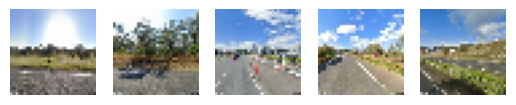

In [8]:
from sklearn import linear_model
from ridge_classifier import evaluate_regressor

i = 1
for image, label in train_ds32_unbatched.take(5):
    plt.subplot(1,5,i)
    plt.imshow(data_visualization.rescale_image(image.numpy()))
    plt.axis('off')
    i += 1

plt.show()

c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_ridge.py:249: LinAlgWarning: Ill-conditioned matrix (rcond=7.55263e-09): result may not be accurate.
  dual_coef = linalg.solve(K, y, assume_a="pos", overwrite_a=False)
c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_ridge.py:249: LinAlgWarning: Ill-conditioned matrix (rcond=7.35186e-09): result may not be accurate.
  dual_coef = linalg.solve(K, y, assume_a="pos", overwrite_a=False)
c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_ridge.py:249: LinAlgWarning: Ill-conditioned matrix (rcond=6.88559e-09): result may not be accurate.
  dual_coef = linalg.solve(K, y, assume_a="pos", overwrite_a=False)
c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_ridge.py:249: LinAlgWarning: Ill-conditioned matrix (rcond=7.85639e-09): result may not be accurate.
  dual_coef 

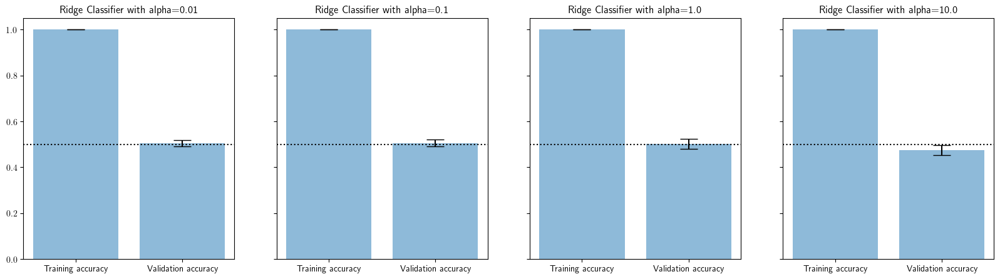

In [11]:
alpha_array = [1e-2,1e-1,1e+0,1e+1]
sample_size = 1000

fig, axs = plt.subplots(nrows = 1, ncols = 4, figsize = (20,5), sharey = True)

for i, alpha in enumerate(alpha_array):
    ridge_classifier = linear_model.RidgeClassifier(alpha = alpha)
    ridge_accuracy_array = np.empty((5,2))
    for j in range(5):
        train_accuracy, val_accuracy = evaluate_regressor(ridge_classifier, sample_size, train_ds32_unbatched, val_ds32_unbatched)
        ridge_accuracy_array[j] = np.array([train_accuracy, val_accuracy])
    plt.sca(axs[i])
    data_visualization.plot_accuracy(ridge_accuracy_array, f'Ridge Classifier with {alpha=}')

plt.show()

After reducing the size of the input drastically, we can observe that we no longer come close to achieving a perfect score on the training dataset. However, this change produced no statistically significant improvement of the score on the validation dataset. In fact, we are even worse off than if we would just guess at random.

## Logistic Regression

I also tried to train this regressor on the 256x256 resolution dataset, however it did not converge within 500 iterations and showed no more promising results than on the smaller 32x32 dataset.

c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/st

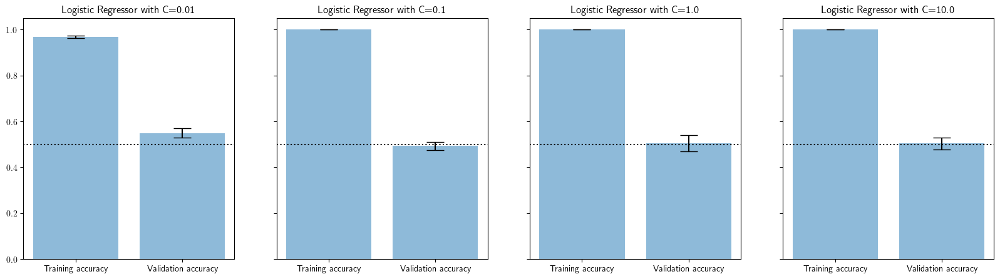

In [12]:
from ridge_classifier import evaluate_regressor

max_iter = 500
sample_size = 500
C_array = [1e-2,1e-1,1e+0,1e+1]

fig, axs = plt.subplots(nrows = 1, ncols = 4, figsize = (20,5), sharey = True)

for i, C in enumerate(C_array):
    logistic_regressor = linear_model.LogisticRegression(C = C, max_iter = max_iter)
    logistic_accuracy_array = np.empty((5,2))
    for j in range(5):
        train_accuracy, val_accuracy = evaluate_regressor(logistic_regressor, sample_size, train_ds32_unbatched, val_ds32_unbatched)
        logistic_accuracy_array[j] = np.array([train_accuracy, val_accuracy])
    plt.sca(axs.flatten()[i])
    data_visualization.plot_accuracy(logistic_accuracy_array, f'Logistic Regressor with {C=}')

plt.show()

## Support vector machines

### Linear Kernel

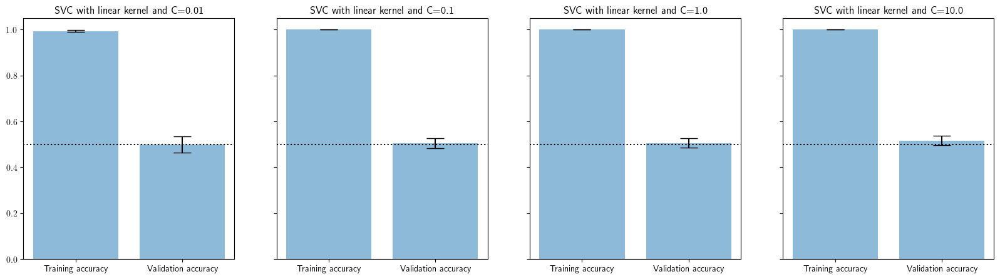

In [2]:
from sklearn import svm
from ridge_classifier import evaluate_regressor

sample_size = 500
C_array = [1e-2,1e-1,1e+0,1e+1]

fig, axs = plt.subplots(nrows = 1, ncols = 4, figsize = (20,5), sharey = True)

for i, C in enumerate(C_array):
    svc_linear = svm.SVC(C = C, kernel = "linear")
    svc_linear_accuracy_array = np.empty((5,2))
    for j in range(5):
        train_accuracy, val_accuracy = evaluate_regressor(svc_linear, sample_size, train_ds32_unbatched, val_ds32_unbatched)
        svc_linear_accuracy_array[j] = np.array([train_accuracy, val_accuracy])
    plt.sca(axs.flatten()[i])
    data_visualization.plot_accuracy(svc_linear_accuracy_array, f'SVC with linear kernel and {C=}')

plt.show()

### Rbf kernel

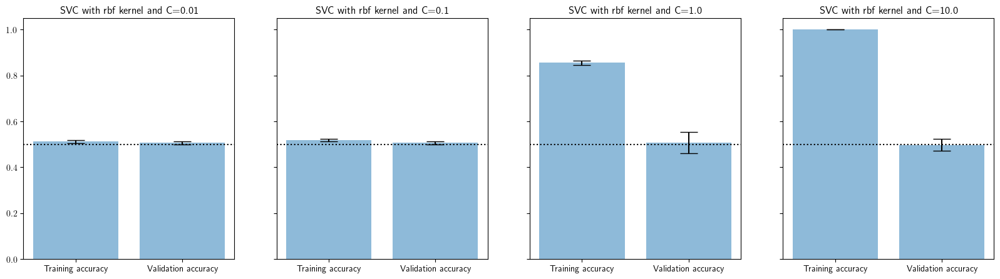

In [3]:
from sklearn import svm
from ridge_classifier import evaluate_regressor

sample_size = 500
C_array = [1e-2,1e-1,1e+0,1e+1]

fig, axs = plt.subplots(nrows = 1, ncols = 4, figsize = (20,5), sharey = True)

for i, C in enumerate(C_array):
    svc_rbf = svm.SVC(C = C, kernel = "rbf")
    svc_rbf_accuracy_array = np.empty((5,2))
    for j in range(5):
        train_accuracy, val_accuracy = evaluate_regressor(svc_rbf, sample_size, train_ds32_unbatched, val_ds32_unbatched)
        svc_rbf_accuracy_array[j] = np.array([train_accuracy, val_accuracy])
    plt.sca(axs.flatten()[i])
    data_visualization.plot_accuracy(svc_rbf_accuracy_array, f'SVC with rbf kernel and {C=}')

plt.show()

Since the strength of the reguralization scales inversely proportional to C, smaller values of C leads to a reduced accuracy on the training dataset. However, none of the above choices for C generalize well to unseen data.

### Sigmoid kernel

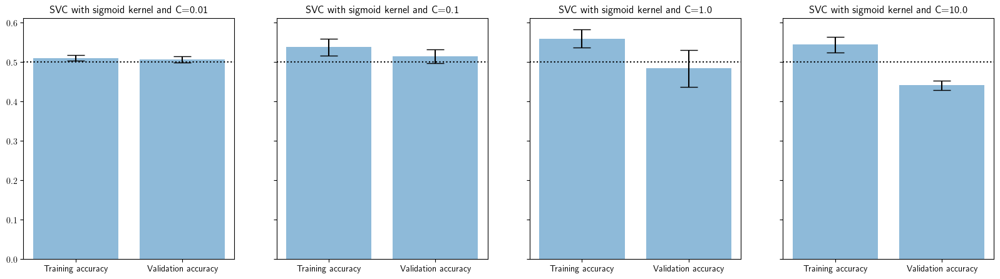

In [4]:
from sklearn import svm
from ridge_classifier import evaluate_regressor

sample_size = 500
C_array = [1e-2,1e-1,1e+0,1e+1]

fig, axs = plt.subplots(nrows = 1, ncols = 4, figsize = (20,5), sharey = True)

for i, C in enumerate(C_array):
    svc_sigmoid = svm.SVC(C = C, kernel = "sigmoid")
    svc_sigmoid_accuracy_array = np.empty((5,2))
    for j in range(5):
        train_accuracy, val_accuracy = evaluate_regressor(svc_sigmoid, sample_size, train_ds32_unbatched, val_ds32_unbatched)
        svc_sigmoid_accuracy_array[j] = np.array([train_accuracy, val_accuracy])
    plt.sca(axs.flatten()[i])
    data_visualization.plot_accuracy(svc_sigmoid_accuracy_array, f'SVC with sigmoid kernel and {C=}')

plt.show()

## Neural network

### Training the model

In [3]:
model = keras.Sequential(
    [
    layers.Conv2D(32, (3,3), input_shape = (256,256,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Flatten(),
    layers.Dense(100),
    layers.Dropout(0.1),
    layers.Dense(1, activation = 'sigmoid'),
    ])

optimizer = optimizers.Adam(learning_rate = 0.001)

model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics = ["accuracy"])
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 256, 256, 32)      896       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 128, 128, 32)     0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 128, 128, 32)      9248      
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 64, 64, 32)       0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 64, 64, 32)        9248      
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 32, 32, 32)      

In [ ]:
history = model.fit(config.train_ds, epochs = 20, validation_data = config.val_ds)

Epoch 1/20
627/627 [==============================] - 510s 811ms/step - loss: 0.3680 - accuracy: 0.8300 - val_loss: 0.3272 - val_accuracy: 0.8733
Epoch 2/20
627/627 [==============================] - 504s 803ms/step - loss: 0.2524 - accuracy: 0.8956 - val_loss: 0.2311 - val_accuracy: 0.9044
Epoch 3/20
627/627 [==============================] - 503s 800ms/step - loss: 0.2093 - accuracy: 0.9158 - val_loss: 0.1807 - val_accuracy: 0.9278
Epoch 4/20
627/627 [==============================] - 511s 814ms/step - loss: 0.1740 - accuracy: 0.9301 - val_loss: 0.1580 - val_accuracy: 0.9385
Epoch 5/20
627/627 [==============================] - 501s 798ms/step - loss: 0.1499 - accuracy: 0.9412 - val_loss: 0.2128 - val_accuracy: 0.9226
Epoch 6/20
627/627 [==============================] - 504s 791ms/step - loss: 0.1332 - accuracy: 0.9491 - val_loss: 0.1784 - val_accuracy: 0.9356
Epoch 7/20
627/627 [==============================] - 516s 821ms/step - loss: 0.1185 - accuracy: 0.9544 - val_loss: 0.1699 -

In [ ]:
model.save('neural_net')

INFO:tensorflow:Assets written to: neural_net/assets


INFO:tensorflow:Assets written to: neural_net/assets


### Evaluation

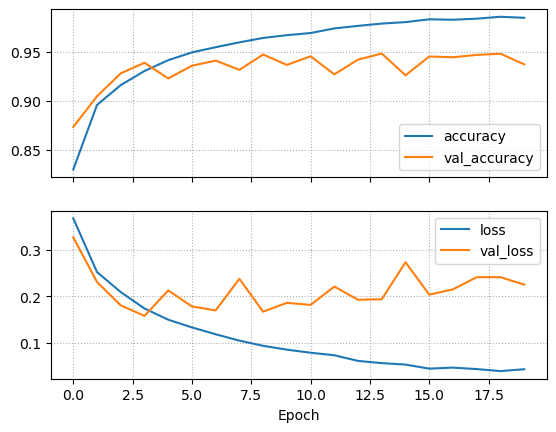

In [ ]:
fig, axs = plt.subplots(2,1, sharex = True)
keys = [["accuracy", "val_accuracy"], ["loss", "val_loss"]]
for (ax, k) in zip(axs,keys):
    for key in k:
        ax.plot(history.history[key], label = key)
    
    ax.legend()
    ax.grid(linestyle = "dotted")

plt.xlabel("Epoch")
plt.show()

In [ ]:
predictions = model.predict(config.val_ds).reshape((5012,))
labels = np.array([x for x in config.val_ds.unbatch().map(lambda x,y: y)])

confidence = 1 - np.abs(predictions - np.round(predictions))
print(f"Average confidence: {100*np.mean(confidence):.2f}%")
print(f"Average confidence (correct labels): {100*np.mean(confidence[np.round(predictions) == labels]):.2f}%")
print(f"Average confidence (wrong labels): {100*np.mean(confidence[np.round(predictions) != labels]):.2f}%")


Average confidence: 97.32%
Average confidence (correct labels): 98.19%
Average confidence (wrong labels): 84.40%


From here on out, we will load the saved version of this model.

In [15]:
predictions = tf.squeeze(config.model.predict(config.val_ds), axis = 1)
labels = np.array([x for x in config.val_ds.unbatch().map(lambda x,y: y)])

157/157 [==============================] - 31s 197ms/step


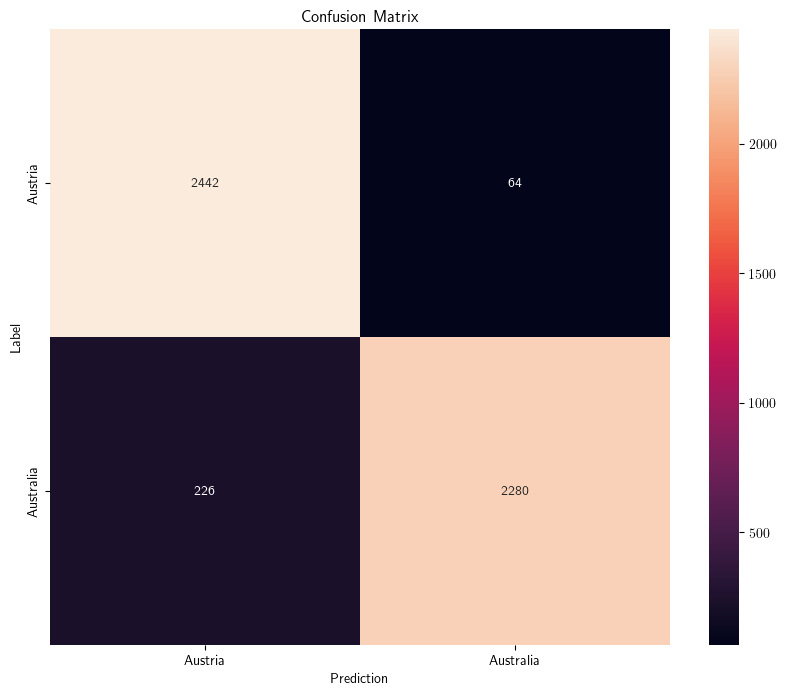

In [16]:
import seaborn as sns

confusion_matrix = tf.math.confusion_matrix(labels, np.round(predictions))
class_names = ["Austria", "Australia"]

sns.heatmap(confusion_matrix,
            xticklabels=class_names,
            yticklabels=class_names,
            annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Label')
plt.title('Confusion Matrix')
plt.show()

### Example images

1/1 [==============================] - 1s 868ms/step


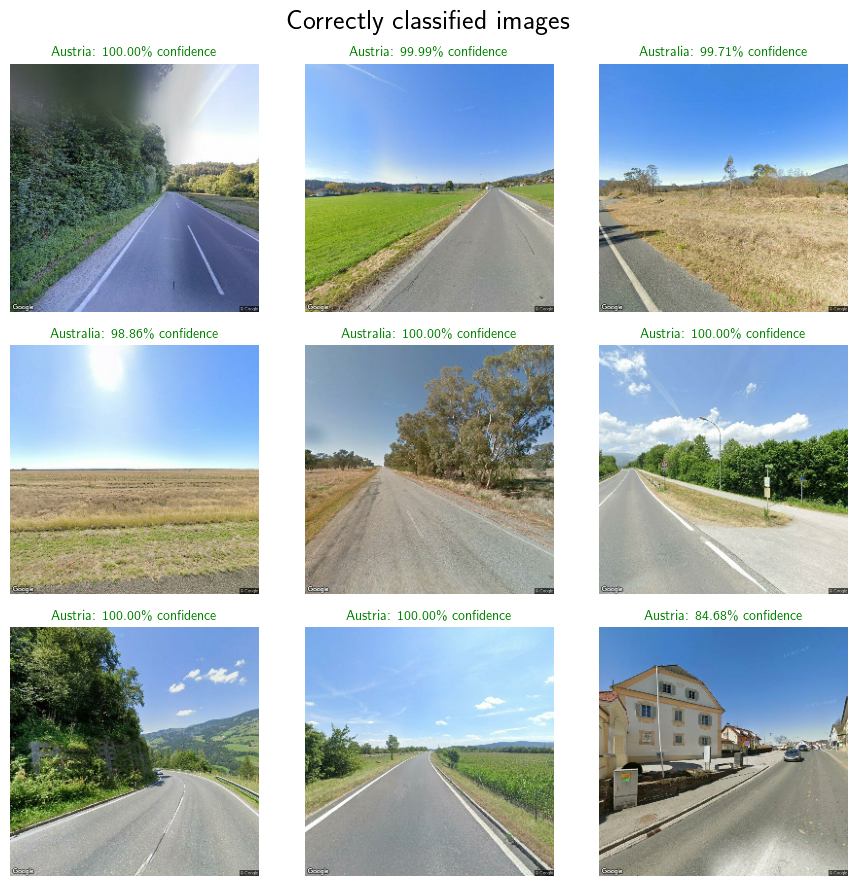

In [8]:
num_images = 9
    
fig = plt.figure(figsize=(9, num_images))
plt.suptitle("Correctly classified images", size = 20)
i = 1
for images, labels in config.val_ds.take(10):
    predictions = config.model.predict(images).reshape((32,))
    for image, prediction, label in zip(images, predictions, labels.numpy()):
        if np.round(prediction) == label:
            ax = plt.subplot(num_images//3, 3, i)
            data_visualization.plot_image_with_confidence(image, label, prediction)
            i += 1
        if i > num_images:
            break
    if i > num_images:
        break
plt.tight_layout()
plt.show()      

1/1 [==============================] - 0s 315ms/step


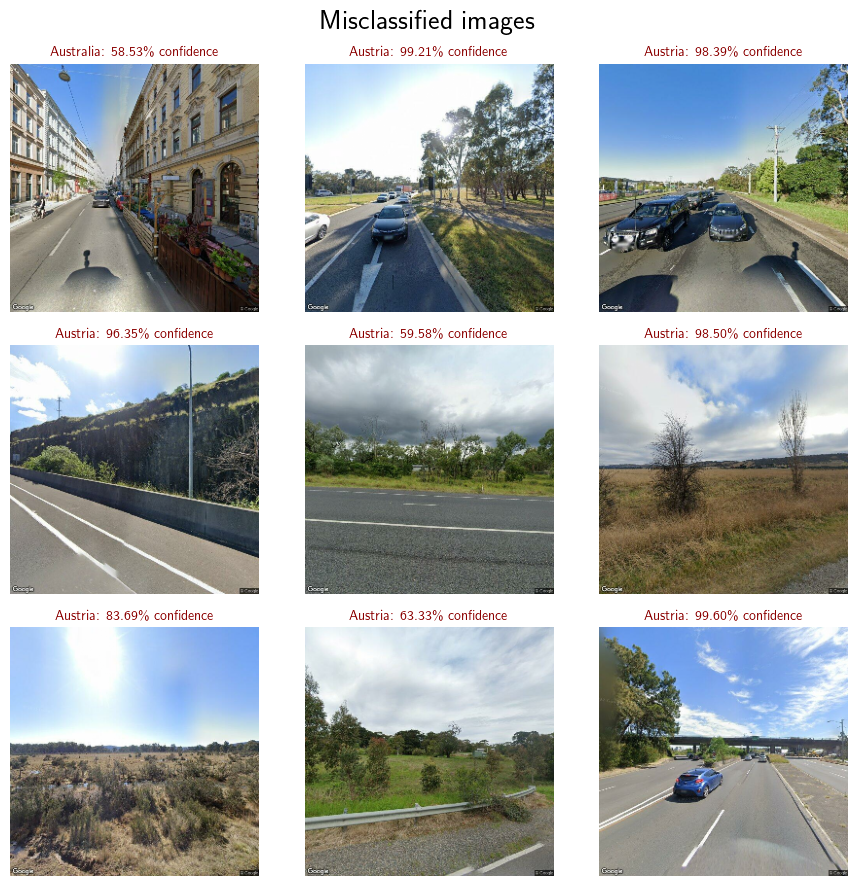

In [10]:
num_images = 9
    
fig = plt.figure(figsize=(9, num_images))
plt.suptitle("Misclassified images", size = 20)
i = 1
for images, labels in config.val_ds.take(10):
    predictions = config.model.predict(images).reshape((32,))
    for image, prediction, label in zip(images, predictions, labels.numpy()):
        if np.round(prediction) != label:
            ax = plt.subplot(num_images//3, 3, i)
            data_visualization.plot_image_with_confidence(image, label, prediction)
            i += 1
        if i > num_images:
            break
    if i > num_images:
        break
plt.tight_layout()
plt.show()      

1/1 [==============================] - 0s 447ms/step


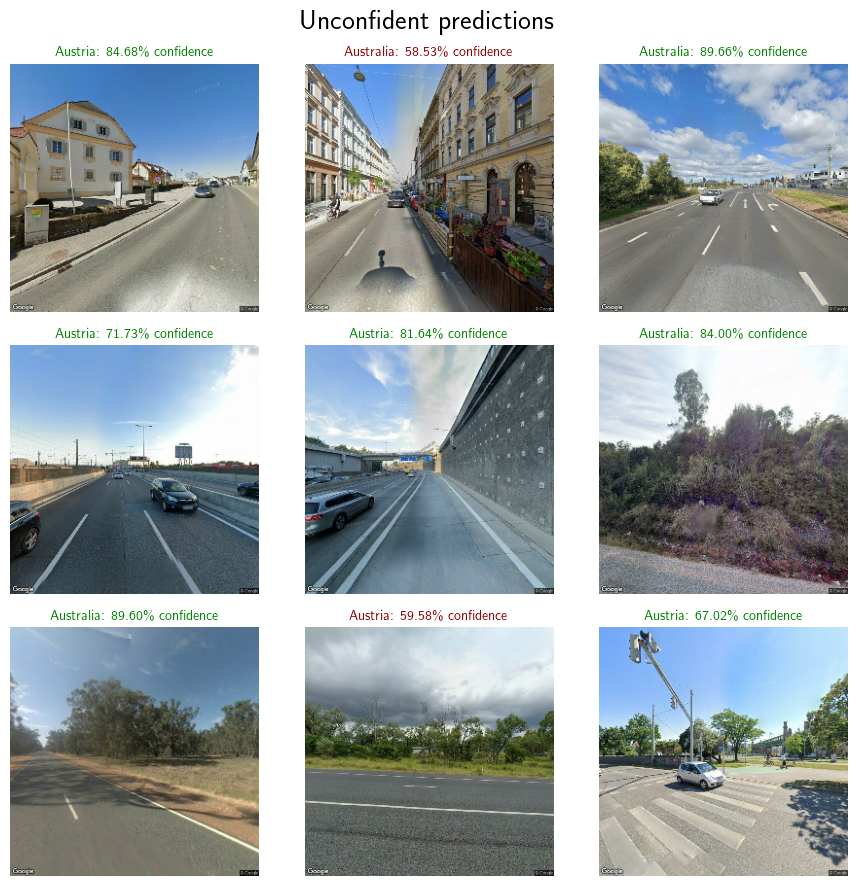

In [11]:
num_images = 9
    
fig = plt.figure(figsize=(9, num_images))
plt.suptitle("Unconfident predictions", size = 20)
i = 1
for images, labels in config.val_ds.take(10):
    predictions = config.model.predict(images).reshape((32,))
    for image, prediction, label in zip(images, predictions, labels.numpy()):
        if prediction > 0.1 and prediction < 0.9:
            ax = plt.subplot(num_images//3, 3, i)
            data_visualization.plot_image_with_confidence(image, label, prediction)
            i += 1
        if i > num_images:
            break
    if i > num_images:
        break
plt.tight_layout()
plt.show()      

### Pre-trained model on imagenet dataset

While I did not expect this pre-trained model to be useful in this setting,
I still wanted to try out what it might identify in my street view images.

In [2]:
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2

imagenet_model = MobileNetV2(
    alpha = 1.0,
    include_top = True,
    weights = 'imagenet',
    input_tensor = None,
    pooling = None,
    classes = 1000,
    classifier_activation = 'softmax'
)

optimizer = optimizers.Adam()
imagenet_model.compile(optimizer = optimizer, metrics = ['accuracy'])

In [3]:
predictions = imagenet_model.predict(config.imagenet_ds)

784/784 [==============================] - 289s 368ms/step


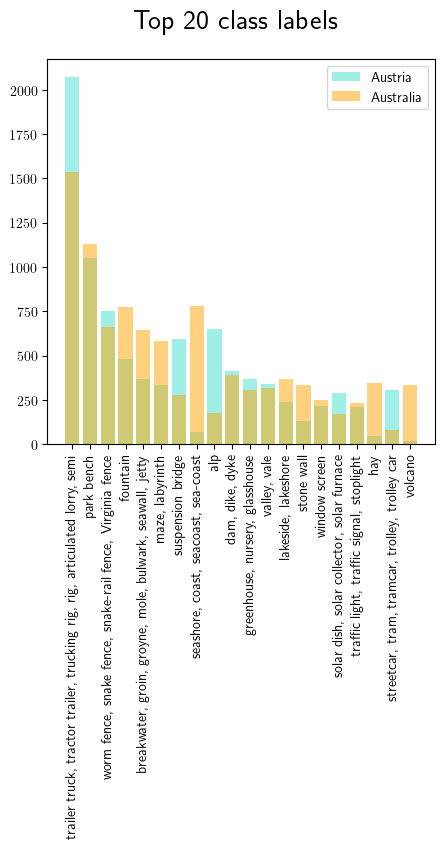

In [4]:
import ast
fig, ax = plt.subplots(figsize = (5,5))

fig.suptitle("Top 20 class labels", size = 20)

with open('imagenet_classnames.txt') as f:
    class_names = ast.literal_eval(f.read())

labels = np.array([x for x in config.imagenet_ds.unbatch().map(lambda x,y: y)])

top_predictions = np.argmax(predictions, axis = 1)
unique, counts = np.unique(top_predictions, return_counts=True)

for j, (country,color) in enumerate(zip(("Austria", "Australia"),("turquoise", "orange"))):
    country_counts = [np.count_nonzero(top_predictions[labels == j] == i) for i in unique[np.argsort(-counts)][:20]]
    ax.bar([class_names[j] for j in unique[np.argsort(-counts)]][:20], country_counts, 
             alpha = 0.5, label = country, color = color)

plt.xticks(rotation=90)
plt.legend()
plt.show()

There are of course some interesting correlations between these classes and the Austria vs. Australia distinction, like the alp category being much more prevalent in Austria and seashores being much more common in Australia. Overall however, I do not think these classes are useful enough to this task at hand to warrant using a pre-trained model like this.

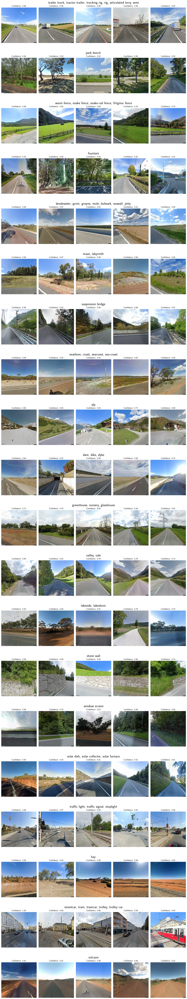

In [6]:
num_classes = 20
fig = plt.figure(figsize=(15, 4*num_classes))
subfigs = fig.subfigures(nrows = num_classes, ncols = 1)

top_predictions = np.argmax(predictions, axis = 1)
unique, counts = np.unique(top_predictions, return_counts=True)

blank_image = np.ones((256,256,3))

axs_array = []
for row, subfig in enumerate(subfigs):
    subfig.suptitle(class_names[unique[np.argsort(-counts)][row]], size = 20)

    axs = subfig.subplots(nrows=1, ncols=5)
    for ax in axs:
        ax.imshow(blank_image)
        ax.axis("off")
    axs_array.append(axs)
confidence_values = np.zeros((num_classes,5))

for batch_number, (images, _) in enumerate(config.imagenet_ds):
    batch_predictions = predictions[32*batch_number:32*(batch_number+1)]
    for row, label in enumerate(unique[np.argsort(-counts)][:num_classes]):
        filter_array = top_predictions[32*batch_number:32*(batch_number+1)] == label
        corresponding_images = images[filter_array]
        corresponding_predictions = batch_predictions[filter_array][:,label]
        sorted_array = sorted(zip(corresponding_predictions, corresponding_images), reverse = True)
        corresponding_images = [image for prediction, image in sorted_array]
        corresponding_predictions = [prediction for prediction, image in sorted_array]
        image_counter = 0
        for i in range(5):
            if image_counter >= len(corresponding_images):
                break
            prediction = corresponding_predictions[image_counter]
            if prediction > confidence_values[row, i]:
                confidence_values[row, i] = prediction
                axs_array[row][i].imshow(data_visualization.rescale_image(corresponding_images[image_counter]))
                axs_array[row][i].set_title(f"Confidence: {prediction:.2f}")
                image_counter += 1
                
plt.tight_layout()
plt.show()


## Multinomial Classification

In [34]:
for country in ["Australia", "Austria", "Czechia", "New Zealand", "Slovakia"]:
    for state in config.states_dict[country]:
        df = pd.read_csv(f"../images_multinomial/{country}/{state}/coordinates.csv")
        image_exists = []
        for index, row in df.iterrows():
            filepath = f"../images_multinomial/{country}/{state}/{int(row['i'])}.jpg"
            if os.path.isfile(filepath):
                image_exists.append(True)
            else:
                image_exists.append(False)
        df["image_exists"] = image_exists
        df.to_csv(f"../images_multinomial/{country}/{state}/coordinates.csv")

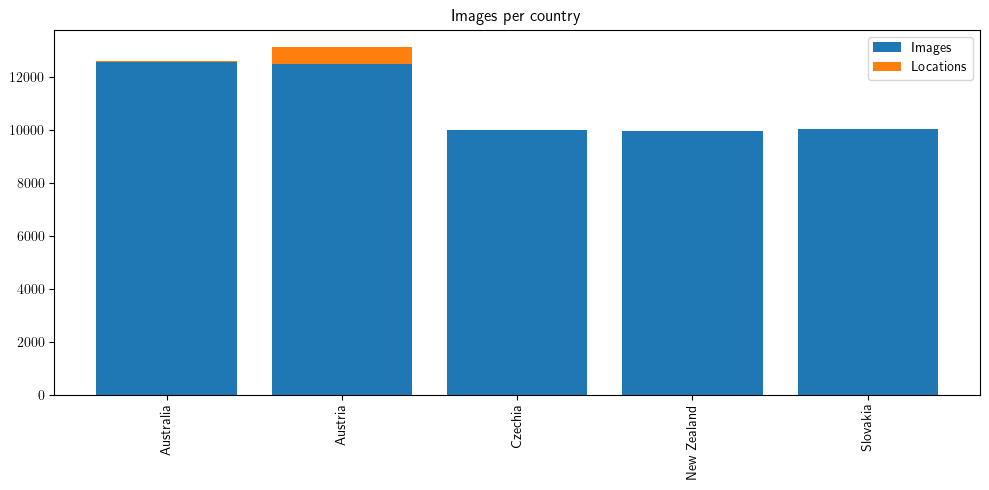

In [37]:
fig, ax = plt.subplots(figsize = (10,5))
countries = ["Australia", "Austria", "Czechia", "New Zealand", "Slovakia"]

num_locations_per_country = []
num_images_per_country = []
for (i,country) in enumerate(countries):
    num_images, num_locations = 0, 0
    for state in config.states_dict[country]:
        df = pd.read_csv(f"../images_multinomial/{country}/{state}/coordinates.csv", index_col= "i")
        num_images += np.sum(df["image_exists"])
        num_locations += len(df)
    num_images_per_country.append(num_images)
    num_locations_per_country.append(num_locations)

ax.bar(countries, num_images_per_country, label = "Images")
ax.bar(countries, np.array(num_locations_per_country) - np.array(num_images_per_country), bottom = num_images_per_country, label = "Locations")
ax.set_title("Images per country")
ax.tick_params('x', labelrotation=45)
ax.legend()
plt.tight_layout()
plt.show()

In [ ]:
model = keras.Sequential(
    [
    layers.Conv2D(32, (3,3), input_shape = (img_height,img_width,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Flatten(),
    layers.Dense(100),
    layers.Dropout(0.1),
    layers.Dense(5, activation = 'softmax'),
    ])

optimizer = optimizers.Adam(learning_rate = 0.001)

model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics = ["accuracy"])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 256, 256, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 128, 128, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      9248      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 64, 64, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 64, 64, 32)        9248      
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 32, 32, 32)       0

In [ ]:
history = model.fit(train_ds_multinomial, epochs = 10, validation_data = val_ds_multinomial)

Epoch 1/10
1377/1377 [==============================] - 1130s 819ms/step - loss: 1.2402 - accuracy: 0.4758 - val_loss: 1.0288 - val_accuracy: 0.5707
Epoch 2/10
1377/1377 [==============================] - 1224s 888ms/step - loss: 0.9698 - accuracy: 0.6034 - val_loss: 0.9257 - val_accuracy: 0.6296
Epoch 3/10
1377/1377 [==============================] - 1271s 923ms/step - loss: 0.8589 - accuracy: 0.6506 - val_loss: 0.8141 - val_accuracy: 0.6735
Epoch 4/10
1377/1377 [==============================] - 1131s 820ms/step - loss: 0.7942 - accuracy: 0.6810 - val_loss: 0.9519 - val_accuracy: 0.6365
Epoch 5/10
1377/1377 [==============================] - 1112s 807ms/step - loss: 0.7431 - accuracy: 0.7016 - val_loss: 0.8363 - val_accuracy: 0.6816
Epoch 6/10
1377/1377 [==============================] - 1123s 815ms/step - loss: 0.7077 - accuracy: 0.7158 - val_loss: 0.9085 - val_accuracy: 0.6577
Epoch 7/10
1377/1377 [==============================] - 1118s 811ms/step - loss: 0.6736 - accuracy: 0.7299

In [ ]:
model.save('multinomial_neural_net')

INFO:tensorflow:Assets written to: multinomial_neural_net/assets


INFO:tensorflow:Assets written to: multinomial_neural_net/assets


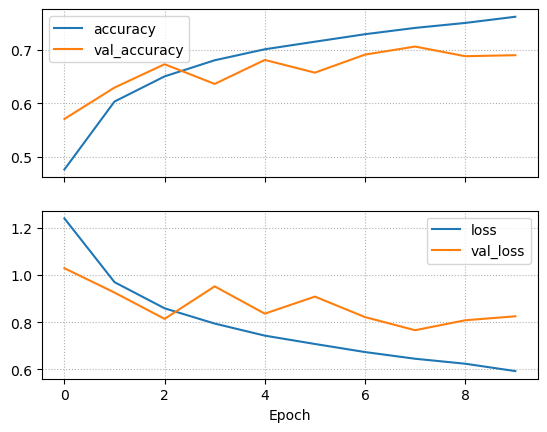

In [ ]:
fig, axs = plt.subplots(2,1, sharex = True)
keys = [["accuracy", "val_accuracy"], ["loss", "val_loss"]]
for (ax, k) in zip(axs,keys):
    for key in k:
        ax.plot(history.history[key], label = key)
    
    ax.legend()
    ax.grid(linestyle = "dotted")

plt.xlabel("Epoch")
plt.show()

In [4]:
multinomial_predictions = config.multinomial_model.predict(config.val_ds_multinomial)
top_multinomial_predictions = np.argmax(predictions, axis = 1)
multinomial_labels = np.array([x for x in config.val_ds_multinomial.unbatch().map(lambda x,y: y)])

345/345 [==============================] - 74s 211ms/step


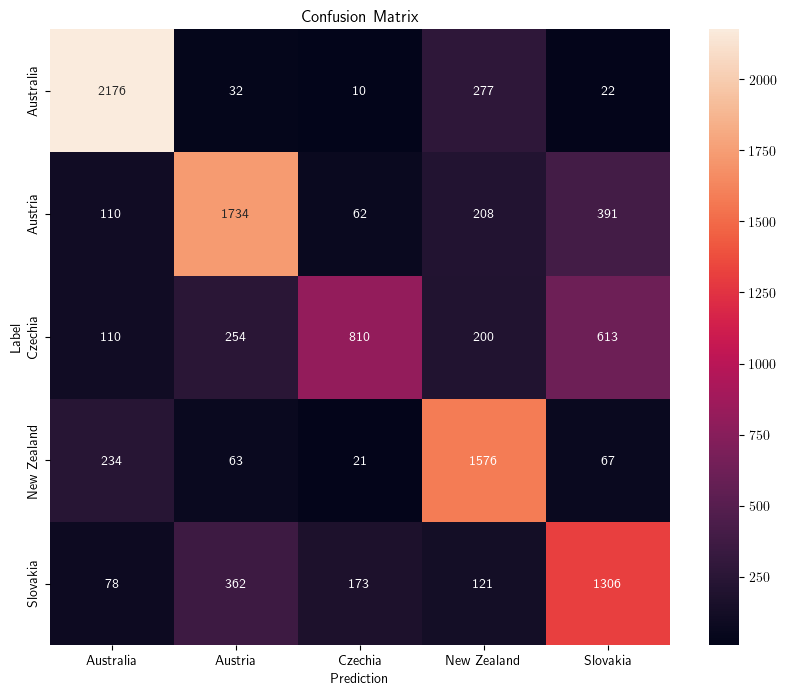

In [6]:
import seaborn as sns

confusion_matrix = tf.math.confusion_matrix(labels, top_multinomial_predictions)
multinomial_class_names = ["Australia", "Austria", "Czechia", "New Zealand", "Slovakia"]

plt.figure(figsize=(10, 8))
sns.heatmap(confusion_matrix,
            xticklabels = multinomial_class_names,
            yticklabels = multinomial_class_names,
            annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Label')
plt.title('Confusion Matrix')
plt.show()

## Adversarial Machine Learning via Signed Gradients

In [2]:
def adversarial_transformation(model, eps):

    def func(image, label):

        with tf.GradientTape() as g:
            g.watch(image)
            predicted_label = model(image)
            loss = losses.BinaryCrossentropy()(label, predicted_label)

            gradient = g.gradient(target = loss, sources = image)
            signed_gradient = tf.sign(gradient)
            adv_image = image + signed_gradient * eps

        return adv_image, label
    
    return func

In [5]:
eps_array = [0,1e-3,1e-2,1e-1,1e-0]


for eps in eps_array:
    print(f"{eps=}")
    if eps == 0:
        loss, accuracy = config.model.evaluate(config.val_ds)
    else:
        adv_ds = config.val_ds.map(adversarial_transformation(config.model, eps))
        loss, accuracy = config.model.evaluate(adv_ds)

eps=0
157/157 [==============================] - 74s 469ms/step - loss: 0.2390 - accuracy: 0.9342
eps=0.001
157/157 [==============================] - 513s 3s/step - loss: 0.4154 - accuracy: 0.8899
eps=0.01
157/157 [==============================] - 490s 3s/step - loss: 3.3498 - accuracy: 0.4523
eps=0.1
157/157 [==============================] - 500s 3s/step - loss: 10.6281 - accuracy: 0.2310
eps=1.0
157/157 [==============================] - 527s 3s/step - loss: 4.8793 - accuracy: 0.4360


1/1 [==============================] - 1s 563ms/step


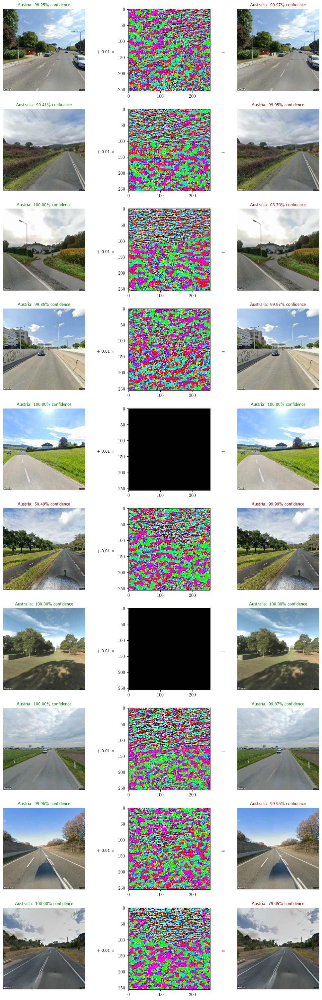

In [4]:
from adversarial_machine_learning import adversarial_transformation

eps = 0.01
num_images = 10
fig = plt.figure(figsize = (10, num_images*3), constrained_layout=True)
subfigs = fig.subfigures(nrows=num_images, ncols=1)

for images, labels in config.val_ds.shuffle(buffer_size = 1000).take(1):
    predictions = config.model.predict(images).reshape((32,))
    adv_images, _ = adversarial_transformation(config.model, eps)(images, labels)
    adv_predictions = config.model.predict(adv_images)
    i = 0
    for image, prediction, adv_image, adv_prediction, label in zip(images, predictions, adv_images, adv_predictions, labels):
        data_visualization.plot_adversarial_image(image, adv_image, label, prediction, adv_prediction, eps, subfigs[i])
        i += 1
        if i >= num_images:
            break
            
plt.show()


As illustrated above there are some images for which the signed gradients method fails, since the gradient is just zero.
This happens, when the loss function attains a minimum at the currently selected image. In practice, this means that the prediction is close enough to 1 (or 0) that it just gets rounded to 1.

## Model Explainability via Integrated Gradients

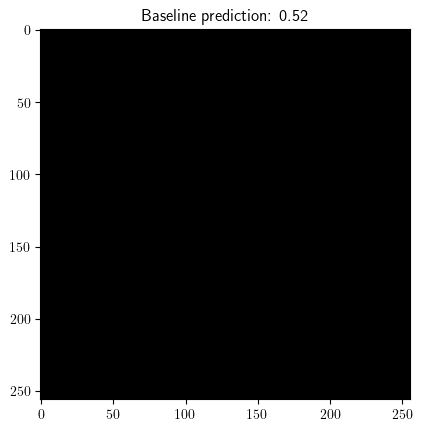

In [7]:
baseline = tf.zeros(shape = ((256,256,3)))

baseline_prediction = config.model(tf.expand_dims(baseline, axis = 0))
plt.imshow(baseline)
plt.title(f"Baseline prediction: {baseline_prediction[0,0]:.2f}")
plt.show()

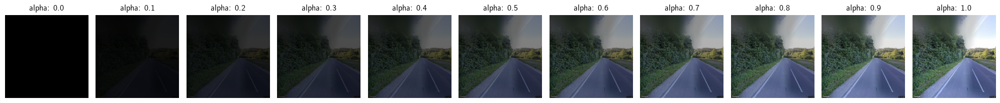

In [11]:
fig = plt.figure(figsize=(20, 20))

for images, labels in config.val_ds.take(1):
    image = images[0]
    image = data_visualization.rescale_image(image, 0, 1)
    for i, alpha in enumerate(np.linspace(0,1,11)):
      plt.subplot(1, 11, i + 1)
      plt.title(f'alpha: {alpha:.1f}')
      plt.imshow(alpha*image)
      plt.axis('off')

    plt.tight_layout()
plt.show()

In [17]:
def get_attributions(image, baseline, m):
    grads = np.zeros((m+1,32, 256,256,3))
    for i in range(m+1):
        current_sample = baseline + (image - baseline)*i/m
        with tf.GradientTape() as g:
            g.watch(current_sample)
            predicted_label = config.model(current_sample)
            grads[i] = g.gradient(target = predicted_label, sources = current_sample)

    avg_grads = np.average((grads[:-1] + grads[1:]) / 2.0, axis = 0)
    return avg_grads*(image-baseline)

In [2]:
from integrated_gradients import get_attributions
from adversarial_machine_learning import adversarial_transformation

# Calculate the integrated gradients

for images, labels in config.val_ds.take(1):
    attributions = get_attributions(images, config.baseline, 50)
    predictions = config.model(images)
    
    adv_images, _ = adversarial_transformation(config.model, 0.05)(images, labels)
    adv_attributions = get_attributions(adv_images, config.baseline, 50)
    adv_predictions = config.model(adv_images)

I use the visualization library https://github.com/ankurtaly/Integrated-Gradients/tree/master/VisualizationLibrary
provided by Ankur Taly, one of the authors of the paper "Axiomatic Attribution for Deep Networks" to mimic the figures presented in this paper.

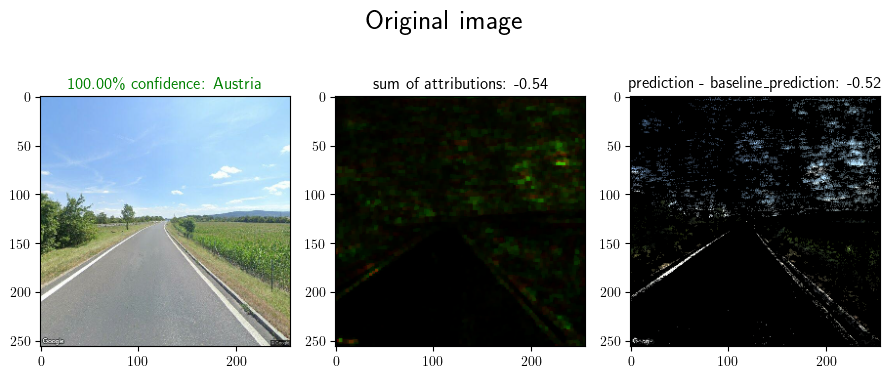

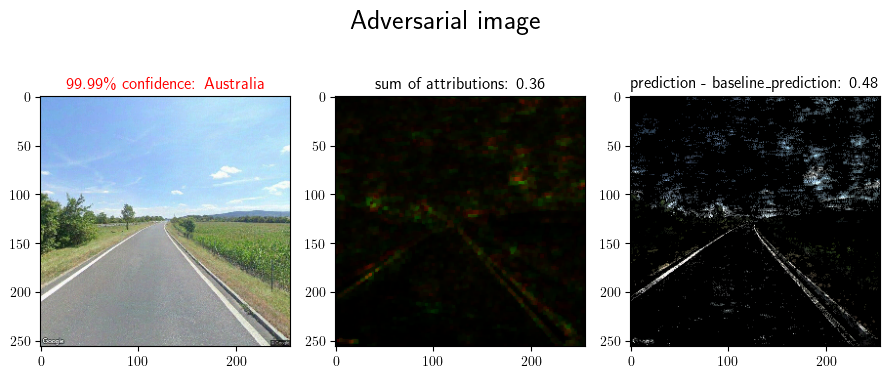

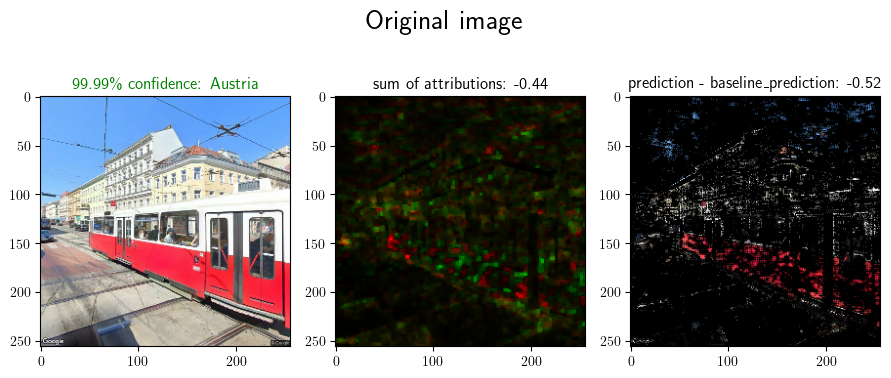

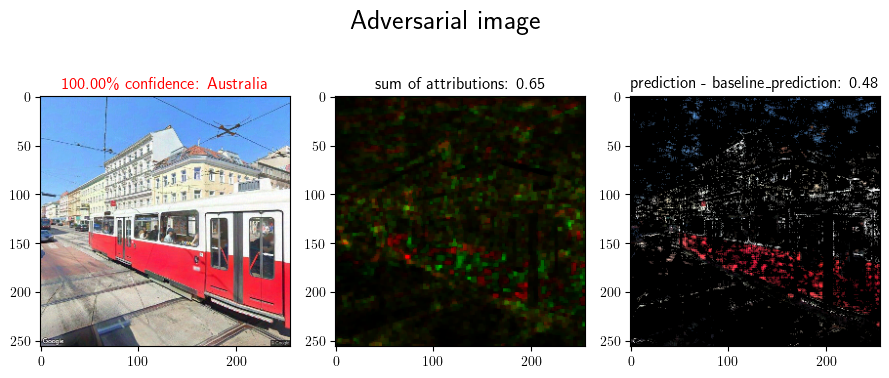

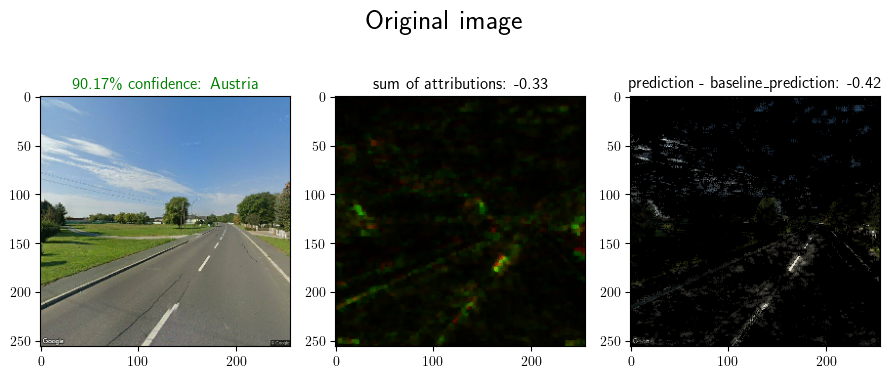

...

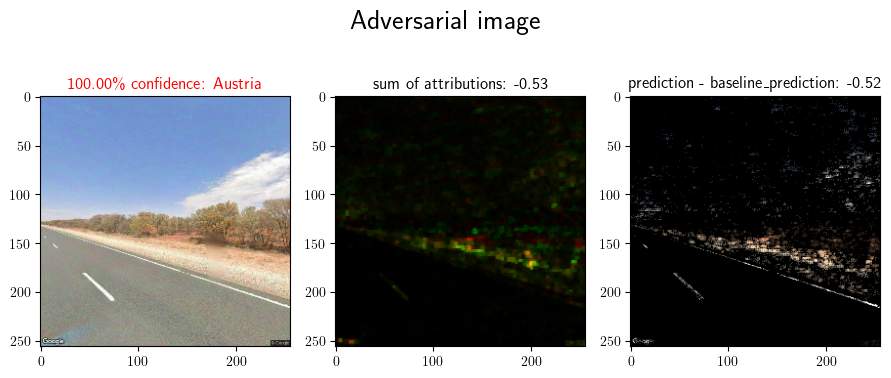

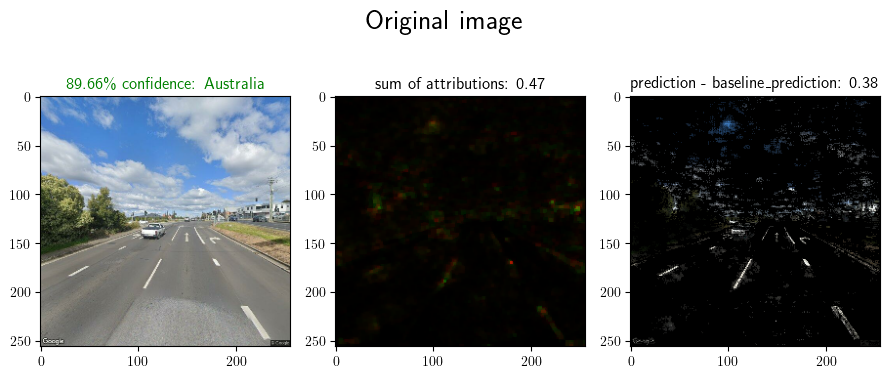

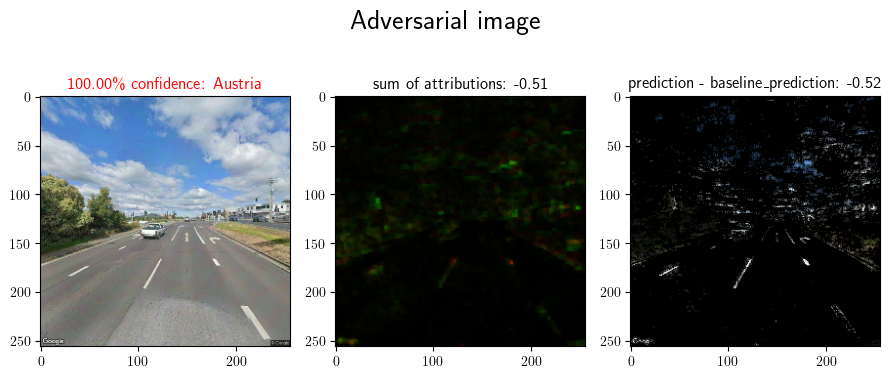

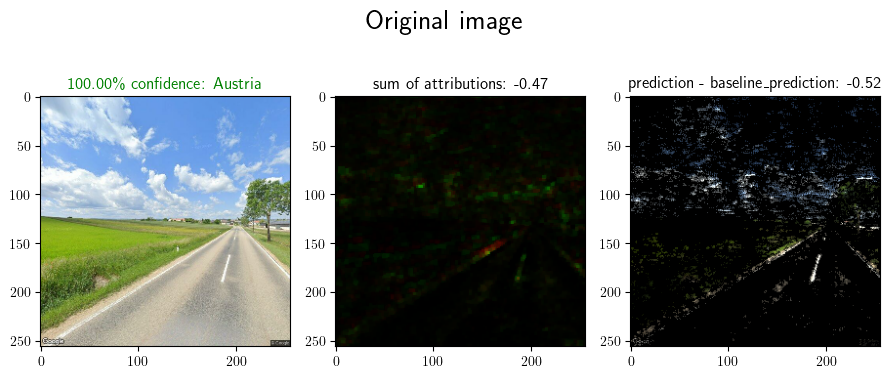

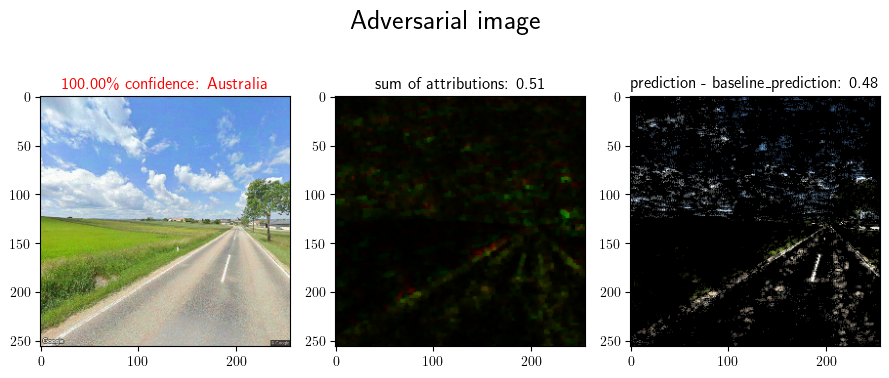

In [11]:
for images, labels in config.val_ds.take(1):
    selected_images = [7,14,15,19,20,27]
    num_images = len(selected_images)
    
    for i in selected_images:
        image = tf.reshape(images[i], (1,256,256,3))
        label = tf.reshape(labels[i], (1,1))
        adv_image = tf.reshape(adv_images[i], (1,256,256,3))
        prediction = predictions[i,0]

        plt.figure(figsize= (9,4))
        plt.suptitle("Original image", size = 20)
        data_visualization.visualize_integrated_gradients(image, label, predictions[i,0], attributions[i])
        plt.show()

        plt.figure(figsize= (9,4))
        plt.suptitle("Adversarial image", size = 20)
        data_visualization.visualize_integrated_gradients(adv_image, label, adv_predictions[i,0], adv_attributions[i])
        plt.show()

Given that is seems harder to pinpoint, which pixels on a street view image present the biggest give-aways whether it is in Australia or Austria, then for cats and dogs, who at least have a clearly defined shape, in a lot of pictures the attributions are all over the place without an obvious interpretation. However there are still some clear patterns emerging: The most prominent feature seem to be the road lines (even though I did not even pick two countries with differing road line colors). In other images the network seems to focus much more on landscape, or sometimes even the sky.